# **Human Emotion Detection**

**This** notebook aims to build a classification model to detect human emotions in the range of **Angry**, **Happy** or **Sad**.  

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Getting Data

In [ ]:
# !pip -q install kaggle

In [ ]:
# ! mkdir ~/.kaggle
# ! cp kaggle.json ~/.kaggle/

In [ ]:
# !chmod 600 /root/.kaggle/kaggle.json

In [ ]:
# !kaggle datasets download -d muhammadhananasghar/human-emotions-datasethes

In [ ]:
# shutil.copy2("/content/human-emotions-datasethes.zip", "/content/drive/MyDrive/")

In [2]:
!unzip -q "/content/drive/MyDrive/human-emotions-datasethes.zip" -d "/content/datasets"

## Imports

In [1]:
!pip -q install onnx
!pip -q install wandb
!pip -q install tf2onnx
!pip -q install onnxruntime
!pip -q install transformers
!pip -q install onnxruntime-gpu
!pip -q install tensorflow-model-optimization
!pip3 -q install --extra-index-url https://google-coral.github.io/py-repo/ tflite_runtime

In [1]:
import tensorflow as tf
import tensorflow_datasets as tfds
import tensorflow_probability as tfp
import tensorflow_model_optimization as tfmot
import tflite_runtime.interpreter as tflite
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import albumentations as A
import onnxruntime as rt
import wandb
import onnx
import tf2onnx
import sklearn
import shutil
import datetime
import pathlib
import random
import time
import cv2
import io
import os
from sklearn.metrics import confusion_matrix, roc_curve
from google.colab import files
from PIL import Image
from transformers import TFViTModel
from wandb.keras import WandbCallback
from onnxruntime.quantization import quantize_dynamic, QuantType

In [ ]:
!wandb login

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: 
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
wandb.tensorboard.patch(root_logdir="/content/logs")
wandb.init(project="emotion-detection-v1", entity="amunipelumi")

wandb: Currently logged in as: amunipelumi. Use `wandb login --relogin` to force relogin


In [ ]:
# wandb.finish()

## Create Dataset

In [2]:
train_directory = '/content/datasets/Emotions Dataset/Emotions Dataset/train'
test_directory = '/content/datasets/Emotions Dataset/Emotions Dataset/test'


CONFIG = {
    'BATCH_SIZE':32,
    'IMAGE_SIZE':256,
    'OUTPUT_UNIT':3,
    'ACTIVATION':'softmax',
    'CLASS_NAMES':['angry', 'happy', 'sad']
}

In [3]:
train_dataset = tf.keras.utils.image_dataset_from_directory(
    train_directory,
    labels='inferred',
    label_mode='int',
    color_mode='rgb',
    shuffle=True,
    seed=13,
    batch_size=CONFIG['BATCH_SIZE'],
    class_names=CONFIG['CLASS_NAMES'],
    image_size=(CONFIG['IMAGE_SIZE'], CONFIG['IMAGE_SIZE']),
)

Found 6799 files belonging to 3 classes.


In [4]:
val_dataset = tf.keras.utils.image_dataset_from_directory(
    test_directory,
    labels='inferred',
    label_mode='int',
    color_mode='rgb',
    shuffle=True,
    seed=13,
    batch_size=CONFIG['BATCH_SIZE'],
    class_names=CONFIG['CLASS_NAMES'],
    image_size=(CONFIG['IMAGE_SIZE'], CONFIG['IMAGE_SIZE'])
)

Found 2278 files belonging to 3 classes.


In [5]:
train_dataset, val_dataset

(<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>,
 <_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>)

image shape: (32, 256, 256, 3), label shape: (32,)



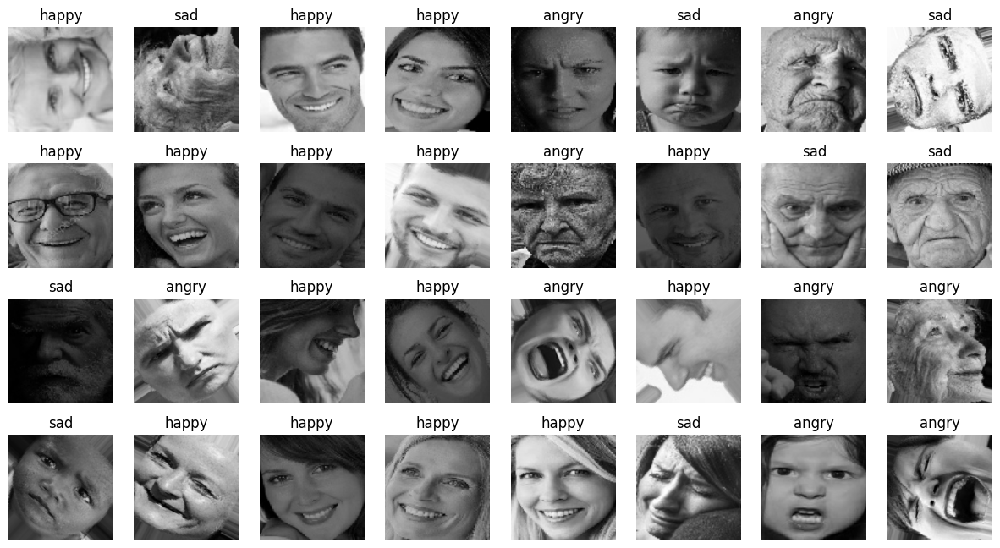

In [7]:
img, label = next(iter(train_dataset))
print(f'image shape: {img.shape}, label shape: {label.shape}\n')

plt.figure(figsize=(15, 8))
for i in range(32):
  plt.subplot(4, 8, i+1)
  plt.imshow(img[i]/255.0)
  plt.title(CONFIG['CLASS_NAMES'][label[i]])
  plt.axis('off')

## Augmenting Dataset

**Simple Augment**

In [6]:
hf_augment = tf.keras.Sequential([
  tf.keras.layers.RandomRotation(factor=(-0.025, 0.025)),
  tf.keras.layers.RandomFlip(mode='horizontal',),
  tf.keras.layers.RandomContrast(factor=0.1),
])

def augment_fn(image, label):
  return hf_augment(image), label

In [7]:
train_dataset = (
    train_dataset
    .map(augment_fn, num_parallel_calls=tf.data.AUTOTUNE)
    .prefetch(tf.data.AUTOTUNE)
)

train_dataset, val_dataset

(<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>,
 <_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>)

In [12]:
# for i, j in train_dataset.take(1):
#   print(i)

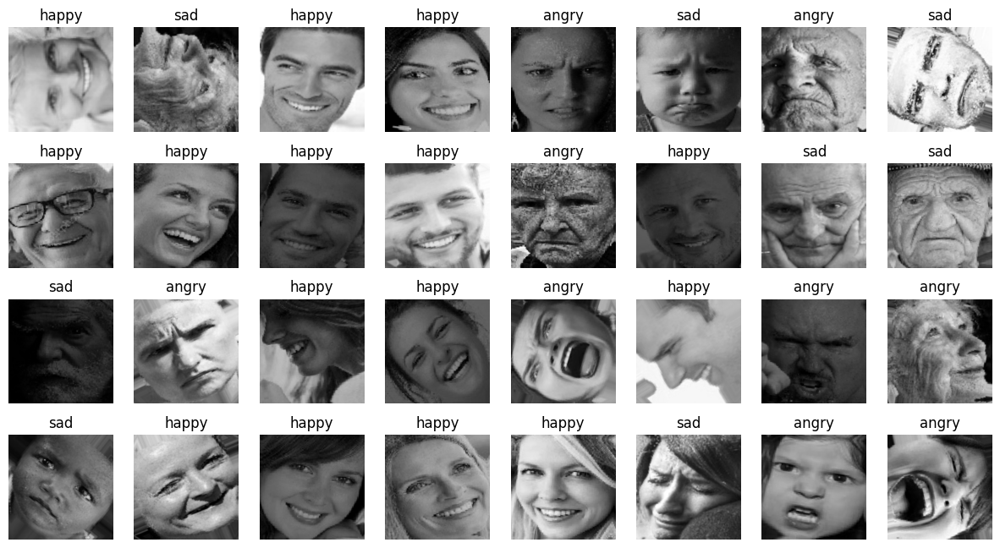

In [8]:
plt.figure(figsize=(15, 8))
for img, label in train_dataset.take(1):
  for i in range(32):
    plt.subplot(4, 8, i+1)
    plt.imshow(img[i]/255)
    plt.title(CONFIG['CLASS_NAMES'][label[i]])
    plt.axis('off')

## Transfer Learning Models

### MobileNetV2

In [15]:
V2BackBone = tf.keras.applications.mobilenet_v2.MobileNetV2(
    include_top=False,
    weights='imagenet',
    input_shape=(CONFIG["IMAGE_SIZE"], CONFIG["IMAGE_SIZE"], 3),
    )

In [17]:
# V2BackBone.summary()

In [18]:
pretrained_v2 = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(CONFIG["IMAGE_SIZE"], CONFIG["IMAGE_SIZE"], 3)),
    tf.keras.layers.Rescaling(1./255),
    V2BackBone,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(1024, activation="relu"),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dense(128, activation="relu"),
    tf.keras.layers.Dense(CONFIG["OUTPUT_UNIT"], activation="softmax"),
    ])

pretrained_v2.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=5e-5),
                      loss=tf.keras.losses.SparseCategoricalCrossentropy(),
                      metrics=['accuracy'])

pretrained_v2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 256, 256, 3)       0         
                                                                 
 mobilenetv2_1.00_224 (Func  (None, 8, 8, 1280)        2257984   
 tional)                                                         
                                                                 
 global_average_pooling2d (  (None, 1280)              0         
 GlobalAveragePooling2D)                                         
                                                                 
 dense (Dense)               (None, 1024)              1311744   
                                                                 
 batch_normalization (Batch  (None, 1024)              4096      
 Normalization)                                                  
                                                      

In [19]:
image_dir = '/content/datasets/Emotions Dataset/Emotions Dataset/train/happy/101883.jpg_rotation_1.jpg'
test_image = cv2.imread(image_dir)
test_image = cv2.resize(test_image, (CONFIG["IMAGE_SIZE"], CONFIG["IMAGE_SIZE"]))

In [20]:
CONFIG['CLASS_NAMES'][tf.argmax(pretrained_v2(tf.expand_dims(test_image, axis=0)), axis=-1)[0]].title()

'Sad'

In [21]:
!rm -rf './logs/tensorboard/mobilenet/'
tensorboard_cb = tf.keras.callbacks.TensorBoard(
    log_dir='./logs/tensorboard/mobilenet/',
    histogram_freq=1
)


early_stopping_cb = tf.keras.callbacks.EarlyStopping(
    monitor='val_accuracy',
    patience=5,
    verbose=1,
    restore_best_weights=True,
    start_from_epoch=5
)

In [22]:
pretrained_v2.fit(train_dataset,
                  validation_data=val_dataset,
                  epochs=25,
                  verbose=1,
                  callbacks=[tensorboard_cb, early_stopping_cb])

Epoch 1/25
213/213 [==============================] - 115s 367ms/step - loss: 0.8746 - accuracy: 0.6132 - val_loss: 1.1803 - val_accuracy: 0.4943
Epoch 2/25
213/213 [==============================] - 64s 299ms/step - loss: 0.5948 - accuracy: 0.7423 - val_loss: 1.4437 - val_accuracy: 0.5075
Epoch 3/25
213/213 [==============================] - 72s 333ms/step - loss: 0.4730 - accuracy: 0.8014 - val_loss: 1.3388 - val_accuracy: 0.5536
Epoch 4/25
213/213 [==============================] - 82s 384ms/step - loss: 0.4050 - accuracy: 0.8376 - val_loss: 1.3378 - val_accuracy: 0.5663
Epoch 5/25
213/213 [==============================] - 62s 286ms/step - loss: 0.3323 - accuracy: 0.8682 - val_loss: 1.4170 - val_accuracy: 0.5768
Epoch 6/25
213/213 [==============================] - 81s 377ms/step - loss: 0.2804 - accuracy: 0.8926 - val_loss: 1.3264 - val_accuracy: 0.5790
Epoch 7/25
213/213 [==============================] - 73s 340ms/step - loss: 0.2463 - accuracy: 0.9062 - val_loss: 1.4030 - val_a

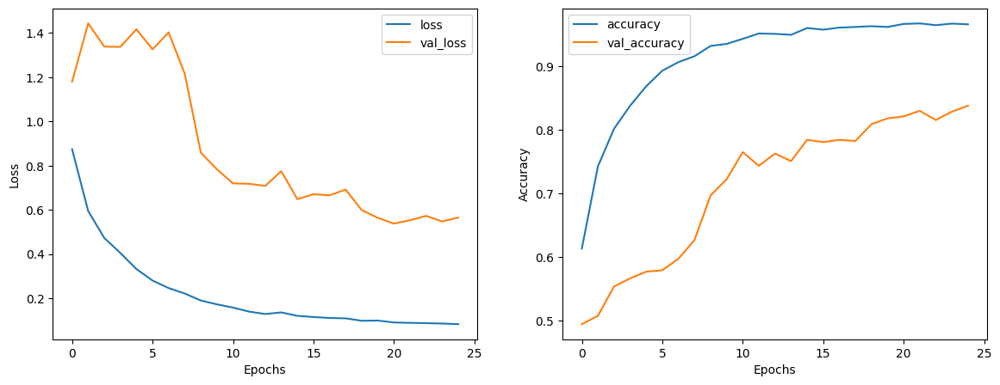

In [24]:
plt.figure(figsize=(14, 5))
plt.subplot(1, 2, 1)
plt.plot(pretrained_v2.history.history['loss'], label='loss')
plt.plot(pretrained_v2.history.history['val_loss'], label='val_loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.subplot(1, 2, 2)
plt.plot(pretrained_v2.history.history['accuracy'], label='accuracy')
plt.plot(pretrained_v2.history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend();

In [ ]:
pretrained_v2.save('/content/drive/MyDrive/Models/M_Net_V2.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [28]:
%load_ext tensorboard

In [29]:
%tensorboard --logdir='/content/logs/tensorboard' --port 6006

<IPython.core.display.Javascript object>

### EfficientNet

In [30]:
EffBackBone = tf.keras.applications.efficientnet.EfficientNetB4(
    include_top=False,
    weights='imagenet',
    input_shape=(CONFIG["IMAGE_SIZE"], CONFIG["IMAGE_SIZE"], 3),
    )

In [ ]:
# EffBackBone.summary()

In [31]:
input = tf.keras.layers.Input(shape=(CONFIG["IMAGE_SIZE"], CONFIG["IMAGE_SIZE"], 3))
x = EffBackBone(input, training=False)
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dense(1024, activation="relu")(x)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.Dense(128, activation="relu")(x)
output = tf.keras.layers.Dense(CONFIG["OUTPUT_UNIT"], activation="softmax")(x)
eff_finetuned = tf.keras.Model(input, output)

eff_finetuned.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=5e-5),
                      loss=tf.keras.losses.SparseCategoricalCrossentropy(),
                      metrics=['accuracy'])

eff_finetuned.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 efficientnetb4 (Functional  (None, 8, 8, 1792)        17673823  
 )                                                               
                                                                 
 global_average_pooling2d_1  (None, 1792)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_3 (Dense)             (None, 1024)              1836032   
                                                                 
 batch_normalization_1 (Bat  (None, 1024)              4096      
 chNormalization)                                                
                                                             

In [32]:
image_dir = '/content/datasets/Emotions Dataset/Emotions Dataset/train/happy/101883.jpg_rotation_1.jpg'
test_image = cv2.imread(image_dir)
test_image = cv2.resize(test_image, (CONFIG["IMAGE_SIZE"], CONFIG["IMAGE_SIZE"]))

In [33]:
CONFIG['CLASS_NAMES'][tf.argmax(eff_finetuned(tf.expand_dims(test_image, axis=0)), axis=-1)[0]].title()

'Happy'

In [34]:
!rm -rf './logs/tensorboard/efficientnet/'
tensorboard_cb = tf.keras.callbacks.TensorBoard(
    log_dir='./logs/tensorboard/efficientnet/',
    histogram_freq=1
)


early_stopping_cb = tf.keras.callbacks.EarlyStopping(
    monitor='val_accuracy',
    patience=5,
    verbose=1,
    restore_best_weights=True,
    start_from_epoch=5
)

In [35]:
eff_finetuned.fit(train_dataset,
                  validation_data=val_dataset,
                  epochs=25,
                  verbose=1,
                  callbacks=[tensorboard_cb, early_stopping_cb])

Epoch 1/25
213/213 [==============================] - 280s 924ms/step - loss: 0.6139 - accuracy: 0.7510 - val_loss: 0.5124 - val_accuracy: 0.8104
Epoch 2/25
213/213 [==============================] - 186s 870ms/step - loss: 0.3084 - accuracy: 0.8770 - val_loss: 0.3727 - val_accuracy: 0.8481
Epoch 3/25
213/213 [==============================] - 186s 870ms/step - loss: 0.2110 - accuracy: 0.9197 - val_loss: 0.3745 - val_accuracy: 0.8696
Epoch 4/25
213/213 [==============================] - 187s 874ms/step - loss: 0.1625 - accuracy: 0.9390 - val_loss: 0.3812 - val_accuracy: 0.8740
Epoch 5/25
213/213 [==============================] - 185s 865ms/step - loss: 0.1272 - accuracy: 0.9516 - val_loss: 0.3630 - val_accuracy: 0.8797
Epoch 6/25
213/213 [==============================] - 186s 871ms/step - loss: 0.1216 - accuracy: 0.9519 - val_loss: 0.3983 - val_accuracy: 0.8753
Epoch 7/25
213/213 [==============================] - 187s 873ms/step - loss: 0.1040 - accuracy: 0.9609 - val_loss: 0.4682 -

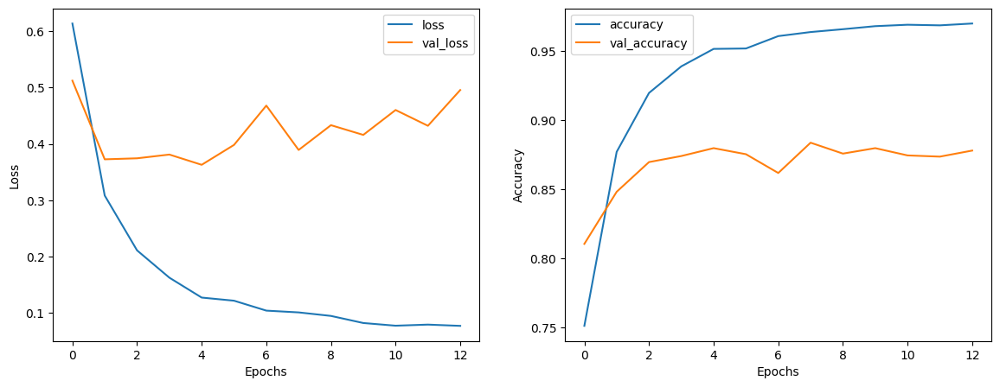

In [38]:
plt.figure(figsize=(14, 5))
plt.subplot(1, 2, 1)
plt.plot(eff_finetuned.history.history['loss'], label='loss')
plt.plot(eff_finetuned.history.history['val_loss'], label='val_loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.subplot(1, 2, 2)
plt.plot(eff_finetuned.history.history['accuracy'], label='accuracy')
plt.plot(eff_finetuned.history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend();

In [ ]:
eff_finetuned.save('/content/drive/MyDrive/Models/Eff_Net_b4.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [39]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [40]:
%tensorboard --logdir='/content/logs/tensorboard' --port 6007

<IPython.core.display.Javascript object>

### HuggingFace ViT

In [41]:
hf_base_model = TFViTModel.from_pretrained("google/vit-base-patch16-224-in21k")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:72: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

tf_model.h5:   0%|          | 0.00/346M [00:00<?, ?B/s]

All model checkpoint layers were used when initializing TFViTModel.

All the layers of TFViTModel were initialized from the model checkpoint at google/vit-base-patch16-224-in21k.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFViTModel for predictions without further training.


In [42]:
hf_base_model.summary()

Model: "tf_vi_t_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vit (TFViTMainLayer)        multiple                  86389248  
                                                                 
Total params: 86389248 (329.55 MB)
Trainable params: 86389248 (329.55 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [43]:
inputs = tf.keras.layers.Input(shape=(224, 224, 3))
x = tf.keras.layers.Rescaling(1./255)(inputs)
x = tf.keras.layers.Permute((3, 1, 2))(x)
x = hf_base_model.vit(x)[0][:, 0, :]
outputs = tf.keras.layers.Dense(CONFIG["OUTPUT_UNIT"], activation='softmax')(x)

hf_model = tf.keras.Model(inputs=inputs, outputs=outputs)

In [44]:
image_dir = '/content/datasets/Emotions Dataset/Emotions Dataset/train/happy/101883.jpg_rotation_1.jpg'
test_image = cv2.imread(image_dir)
test_image = cv2.resize(test_image, (224, 224))

In [45]:
CONFIG['CLASS_NAMES'][tf.argmax(hf_model(tf.expand_dims(test_image, axis=0)), axis=-1)[0]].title()

'Sad'

In [46]:
hf_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=5e-5),
                 loss=tf.keras.losses.SparseCategoricalCrossentropy(),
                 metrics=['accuracy'])

hf_model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 rescaling_3 (Rescaling)     (None, 224, 224, 3)       0         
                                                                 
 permute (Permute)           (None, 3, 224, 224)       0         
                                                                 
 vit (TFViTMainLayer)        TFBaseModelOutputWithPo   86389248  
                             oling(last_hidden_state             
                             =(None, 197, 768),                  
                              pooler_output=(None, 7             
                             68),                                
                              hidden_states=None, at             
                             tentions=None)                

**Create Dataset to Suit HF**

In [47]:
train_hf = tf.keras.utils.image_dataset_from_directory(
    train_directory,
    labels='inferred',
    label_mode='int',
    color_mode='rgb',
    shuffle=True,
    seed=13,
    image_size=(224, 224),
    batch_size=CONFIG['BATCH_SIZE'],
    class_names=CONFIG['CLASS_NAMES'],
)

Found 6799 files belonging to 3 classes.


In [48]:
val_hf = tf.keras.utils.image_dataset_from_directory(
    test_directory,
    labels='inferred',
    label_mode='int',
    color_mode='rgb',
    shuffle=True,
    seed=13,
    image_size=(224, 224),
    batch_size=CONFIG['BATCH_SIZE'],
    class_names=CONFIG['CLASS_NAMES'],
)

Found 2278 files belonging to 3 classes.


In [49]:
train_hf = train_hf.map(augment_fn, num_parallel_calls=tf.data.AUTOTUNE)
train_hf, val_hf

(<_ParallelMapDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>,
 <_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>)

In [51]:
# for x, y in train_hf.take(1):
#   print(x)

In [ ]:
val_hf2 = tf.keras.utils.image_dataset_from_directory(
    test_directory,
    labels='inferred',
    label_mode='int',
    color_mode='rgb',
    shuffle=True,
    seed=13,
    image_size=(224, 224),
    batch_size=1,
    class_names=CONFIG['CLASS_NAMES'],
)

val_hf2

In [52]:
!rm -rf './logs/tensorboard/huggingface'
tensorboard_cb = tf.keras.callbacks.TensorBoard(
    log_dir='./logs/tensorboard/huggingface',
    histogram_freq=1
)


early_stopping_cb = tf.keras.callbacks.EarlyStopping(
    monitor='val_accuracy',
    patience=5,
    verbose=1,
    restore_best_weights=True,
    start_from_epoch=5
)

In [53]:
# tf.config.run_functions_eagerly(True)
hf_model.fit(train_hf,
             validation_data=val_hf,
             epochs=25,
             verbose=1,
             callbacks=[tensorboard_cb, early_stopping_cb])

Epoch 1/25


213/213 [==============================] - 367s 2s/step - loss: 0.4891 - accuracy: 0.7989 - val_loss: 0.3585 - val_accuracy: 0.8582
Epoch 2/25
213/213 [==============================] - 318s 1s/step - loss: 0.2943 - accuracy: 0.8860 - val_loss: 0.3220 - val_accuracy: 0.8753
Epoch 3/25
213/213 [==============================] - 318s 1s/step - loss: 0.2145 - accuracy: 0.9176 - val_loss: 0.2793 - val_accuracy: 0.8951
Epoch 4/25
213/213 [==============================] - 328s 2s/step - loss: 0.1590 - accuracy: 0.9381 - val_loss: 0.3421 - val_accuracy: 0.8942
Epoch 5/25
213/213 [==============================] - 318s 1s/step - loss: 0.1333 - accuracy: 0.9476 - val_loss: 0.3201 - val_accuracy: 0.8907
Epoch 6/25
213/213 [==============================] - 319s 1s/step - loss: 0.1158 - accuracy: 0.9546 - val_loss: 0.3015 - val_accuracy: 0.9065
Epoch 7/25
213/213 [==============================] - 315s 1s/step - loss: 0.1064 - accuracy: 0.9575 - val_loss: 0.3283 - val_accuracy: 0.8982
Epoch 8/25

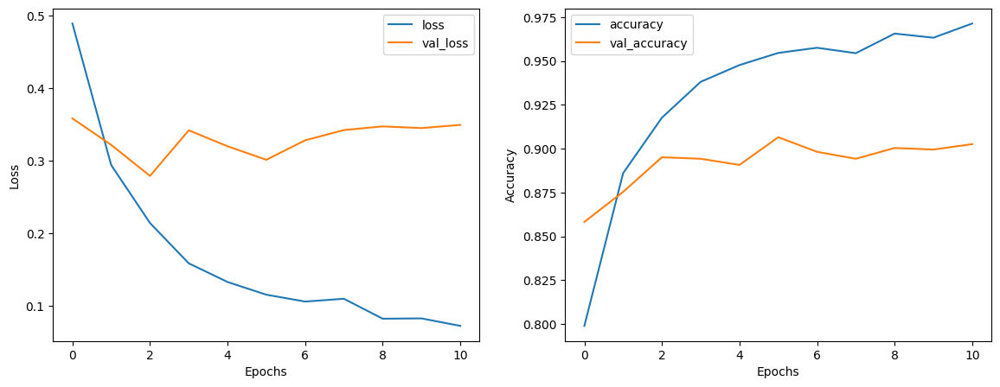

In [54]:
plt.figure(figsize=(14, 5))
plt.subplot(1, 2, 1)
plt.plot(hf_model.history.history['loss'], label='loss')
plt.plot(hf_model.history.history['val_loss'], label='val_loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.subplot(1, 2, 2)
plt.plot(hf_model.history.history['accuracy'], label='accuracy')
plt.plot(hf_model.history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend();

In [ ]:
hf_model.save('/content/drive/MyDrive/Models/Hf_ViT.h5')

In [56]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [57]:
%tensorboard --logdir='/content/logs/tensorboard' --port 6008

<IPython.core.display.Javascript object>

## Evaluate

In [58]:
model = eff_finetuned
model.evaluate(val_dataset)

72/72 [==============================] - 13s 181ms/step - loss: 0.3894 - accuracy: 0.8837


[0.38935697078704834, 0.883669912815094]

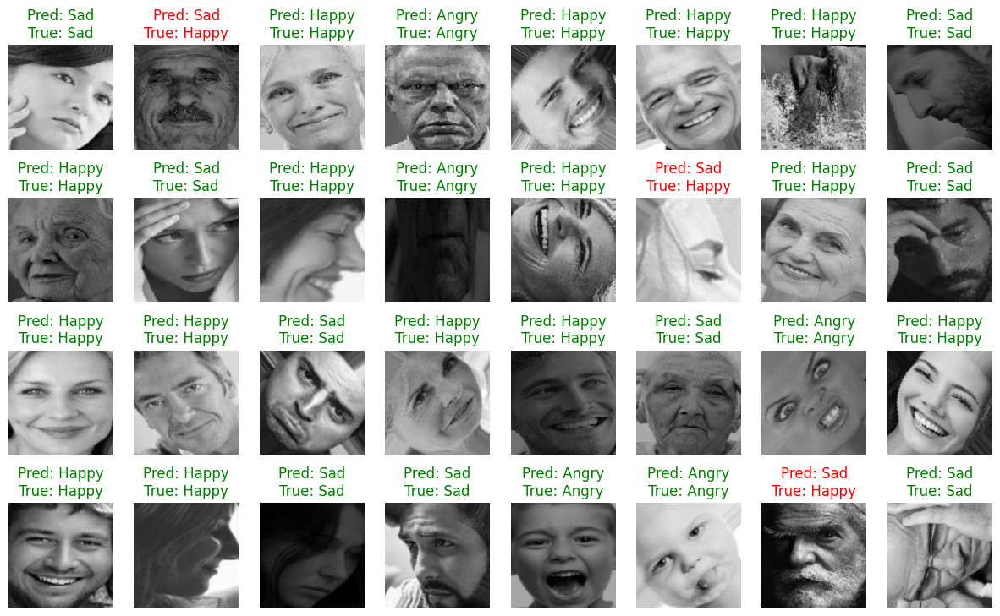

In [60]:
img, label = next(iter(val_dataset))

plt.figure(figsize=(15, 9))
for i in range(32):
  plt.subplot(4, 8, i+1)
  plt.imshow(img[i]/255)
  prediction = CONFIG['CLASS_NAMES'][tf.argmax(model(tf.expand_dims(img[i], axis=0)), axis=-1).numpy()[0]].title()
  actual = CONFIG['CLASS_NAMES'][label[i]].title()
  text = f'Pred: {prediction}\nTrue: {actual}'
  if prediction == actual:
    plt.title(text, color='green')
  else:
    plt.title(text, color='red')
  plt.axis('off')

In [61]:
(32-3)/32

0.90625

In [62]:
preds = []
labels = []

for image, label in val_dataset.as_numpy_iterator():
  preds.append(model(image))
  labels.append(label)

In [65]:
len(preds[:-1]), len(preds[-1]), len(labels[:-1]), len(labels[-1])

(71, 6, 71, 6)

In [66]:
# tf.config.run_functions_eagerly(True)
preds = np.concatenate([np.argmax(preds[:-1], axis=-1).flatten(), np.argmax(preds[-1], axis=-1).flatten()])
labels = np.concatenate(labels, axis=None)

preds, labels

(array([0, 1, 0, ..., 1, 0, 0]), array([0, 1, 0, ..., 1, 0, 0], dtype=int32))

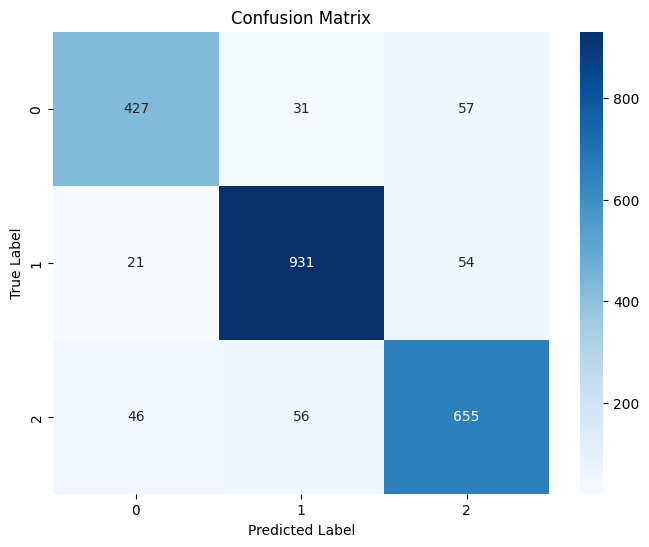

In [67]:
cm = confusion_matrix(labels, preds)
ticks = np.arange(cm.shape[0])
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=ticks, yticklabels=ticks)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

**Test Model on Single Image**

In [71]:
test_img = cv2.imread("/content/datasets/Emotions Dataset/Emotions Dataset/test/angry/112345.jpg")
test_img = cv2.resize(test_img, (CONFIG["IMAGE_SIZE"] ,CONFIG["IMAGE_SIZE"]))
img = tf.expand_dims(tf.constant(test_img, dtype=tf.float32), axis=0)
pred_value = model.predict(img)
print(pred_value)
print('\nPredicted label:', CONFIG['CLASS_NAMES'][np.argmax(pred_value, axis=-1)[0]].title())

1/1 [==============================] - 0s 122ms/step
[[9.9748790e-01 1.5285334e-03 9.8346511e-04]]

Predicted label: Angry


## Feature Map Visualization

**GradCam**

In [72]:
x = EffBackBone.output
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dense(1024, activation="relu")(x)
x = tf.keras.layers.Dense(128, activation="relu")(x)
output = tf.keras.layers.Dense(CONFIG["OUTPUT_UNIT"], activation="softmax")(x)
eff_model = tf.keras.Model(EffBackBone.inputs, output)

In [92]:
# eff_model.summary()

In [73]:
test_image = cv2.imread('/content/datasets/Emotions Dataset/Emotions Dataset/test/angry/142544.jpg')
test_image = cv2.resize(test_image, (CONFIG["IMAGE_SIZE"], CONFIG["IMAGE_SIZE"]))
img = tf.constant(test_image, dtype=tf.float32)
img_array = tf.expand_dims(img, axis=0)
print(img_array.shape)

(1, 256, 256, 3)


In [79]:
preds = eff_model.predict(img_array)
print(preds, '\n')
CONFIG['CLASS_NAMES'][np.argmax(preds, axis=-1)[0]].title()

1/1 [==============================] - 0s 84ms/step
[[0.31072935 0.26675278 0.42251787]] 



'Sad'

In [86]:
last_conv_layer = eff_model.get_layer("top_activation")
last_conv_layer_model = tf.keras.Model(eff_model.inputs, last_conv_layer.output)

In [87]:
# last_conv_layer_model.summary()

In [88]:
## classifier names from eff_model

classifier_layer_names = [
 "global_average_pooling2d_2",
 "dense_7",
 "dense_8",
 "dense_9"
]

In [91]:
classifier_input = tf.keras.layers.Input(shape=(8, 8, 1792))
x = classifier_input
for layer_name in classifier_layer_names:
  x = eff_model.get_layer(layer_name)(x)
classifier_model = tf.keras.Model(classifier_input, x)

In [96]:
with tf.GradientTape() as tape:
  last_conv_layer_output = last_conv_layer_model(img_array)
  preds = classifier_model(last_conv_layer_output)
  top_pred_index = tf.argmax(preds[0])
  print(top_pred_index)
  top_class_channel = preds[:, top_pred_index]

grads = tape.gradient(top_class_channel, last_conv_layer_output)
grads.shape

tf.Tensor(2, shape=(), dtype=int64)


TensorShape([1, 8, 8, 1792])

In [97]:
pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2)).numpy()
print(pooled_grads.shape)

last_conv_layer_output = last_conv_layer_output.numpy()[0]
for i in range(1792):
  last_conv_layer_output[:, :, i] *= pooled_grads[i]

print(last_conv_layer_output.shape)

(1792,)
(8, 8, 1792)


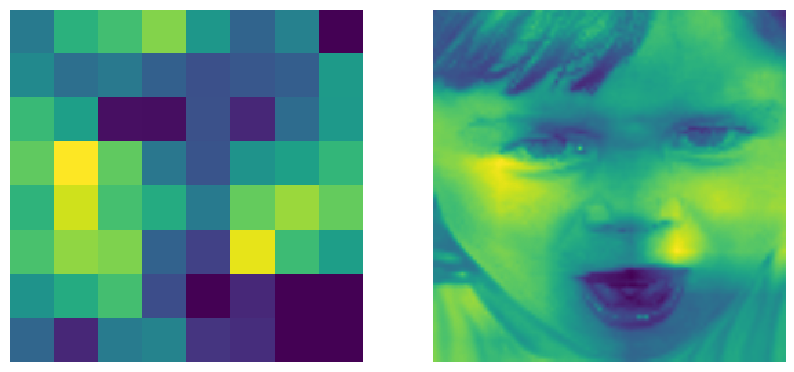

In [98]:
heatmap = tf.nn.relu(np.sum(last_conv_layer_output, axis=-1))
resized_heatmap = cv2.resize(np.array(heatmap), (256, 256))
resized_heatmap = resized_heatmap * 255 + img_array[0, :, :, 0] / 255

fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].matshow(heatmap)
axs[1].matshow(resized_heatmap)
for ax in axs:
    ax.axis('off')

## Export to ONNX Format

In [ ]:
rt.get_device()

'GPU'

**From Keras Model**

In [ ]:
os.makedirs("/content/drive/MyDrive/ONNX", exist_ok=True)

In [99]:
model = tf.keras.models.load_model('./Eff_Net_B4.h5')

In [100]:
output_path = './Eff_Net_B4.onnx'

In [ ]:
model = tf.keras.models.load_model('/content/drive/MyDrive/Models/Eff_Net_B4.h5')
output_path = '/content/drive/MyDrive/ONNX/Eff_Net_B4.onnx'

In [101]:
input_signature = [
    tf.TensorSpec(
        [None, 256, 256, 3],
        tf.float32,
        name='input'
    )
]


onnx_model, _ = tf2onnx.convert.from_keras(model, input_signature, opset=13)
onnx.save(onnx_model, output_path)

output_names = [n.name for n in onnx_model.graph.output]
print(f'\n{output_names}')


['dense_5']


**Inference**

In [102]:
test_image = cv2.imread('/content/datasets/Emotions Dataset/Emotions Dataset/test/sad/120514.jpg')
test_image = cv2.resize(test_image, (256, 256))
img = test_image.astype(np.float32)

img = np.expand_dims(img, axis=0)

*Benchmarking ONNX*

In [105]:
# 'CPUExecutionProvider'
m = rt.InferenceSession('/content/drive/MyDrive/ONNX/Eff_Net_B4.onnx', providers=['CUDAExecutionProvider'])

t1 = time.time()

for _ in range(10):
  onnx_pred = m.run(['dense_5'], {"input": img})

t2 = time.time()

print(f'{onnx_pred}\n')
print(f'{np.argmax(onnx_pred)}\n')
pred_label = CONFIG['CLASS_NAMES'][np.argmax(onnx_pred)]
print(f'{pred_label}\n')
print('Time for a single ONNX prediction', (t2 - t1) / 10)

[array([[1.3670409e-06, 2.0668205e-05, 9.9997795e-01]], dtype=float32)]

2

sad

Time for a single ONNX prediction 0.14053843021392823


*Benchmarking TF*

In [107]:
tf_model = tf.keras.models.load_model('/content/drive/MyDrive/Models/Eff_Net_B4.h5')

t1 = time.time()

for _ in range(10):
  tf_pred = tf_model(img)

t2 = time.time()

print(f'{tf_pred}\n')
print(f'{np.argmax(tf_pred)}\n')
tf_pred_label = CONFIG['CLASS_NAMES'][np.argmax(tf_pred)]
print(f'{tf_pred_label}\n')
print('Time for a single TF prediction', (t2 - t1) / 10)

[[1.3670409e-06 2.0668205e-05 9.9997795e-01]]

2

sad

Time for a single TF prediction 0.39535322189331057


### Quantization with ONNX

In [108]:
model_float32 = './Eff_Net_B4.onnx'
model_quantized = './Eff_Net_Quantized.onnx'

quantized_model = quantize_dynamic(model_float32, model_quantized, weight_type=QuantType.QUInt8)

In [ ]:
model_float32 = '/content/drive/MyDrive/ONNX/Eff_Net_B4.onnx'
model_quantized = '/content/drive/MyDrive/Quantized/Eff_Net_Quantized.onnx'

quantized_model = quantize_dynamic(model_float32, model_quantized, weight_type=QuantType.QUInt8)

**Accuracy Drops**

In [17]:
def accuracy(model):
  total, acc = 0, 0

  for img, label in val_dataset.unbatch().take(100):
    onnx_pred = model.run(['dense_5'], {"input": np.expand_dims(img, axis=0)})

    if(int(np.argmax(onnx_pred, axis=-1)) == int(np.argmax(label, axis=-1))):
      acc += 1

    total += 1

  return acc/total

In [ ]:
# ## testing unquantized onnx on 100 images
# m = rt.InferenceSession('/content/drive/MyDrive/ONNX/Eff_Net_B4.onnx', providers=['CUDAExecutionProvider'])
# print(accuracy(m))

In [21]:
# ## testing quantized
# m_q = rt.InferenceSession('/content/drive/MyDrive/Quantized/Eff_Net_Quantized.onnx', providers=['CUDAExecutionProvider'])
# print(accuracy(m_q))

In [25]:
# using quantized model on a single image
test_image = cv2.imread('/content/datasets/Emotions Dataset/Emotions Dataset/test/happy/542042.jpg_rotation_2.jpg')
print('\n', test_image.shape)

test_image = cv2.resize(test_image, (256, 256))
img = np.float32(test_image)
img_array = np.expand_dims(img, axis=0)
print('\n', img_array.shape)

m_q = rt.InferenceSession('/content/drive/MyDrive/Quantized/Eff_Net_Quantized.onnx', providers=['CPUExecutionProvider'])
onnx_pred = m_q.run(['dense_5'], {'input':img_array})
pred_label = CONFIG['CLASS_NAMES'][np.argmax(onnx_pred)].title()
print(f'\nPredicted label: {pred_label}')


 (224, 224, 3)

 (1, 256, 256, 3)

Predicted label: Happy


### Quantization with TensorFlow

**Quantization Aware Training**

In [ ]:
EffBackBone = tf.keras.applications.efficientnet.EfficientNetB4(
    include_top=False,
    weights='imagenet',
    input_shape=(CONFIG["IMAGE_SIZE"], CONFIG["IMAGE_SIZE"], 3),
    )

In [ ]:
EffBackBone
x = tf.keras.layers.GlobalAveragePooling2D()(EffBackBone.output)
x = tf.keras.layers.Dense(1024, activation='relu')(x)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.Dense(128, activation='relu')(x)
output = tf.keras.layers.Dense(CONFIG["OUTPUT_UNIT"], activation='softmax')(x)

pretrained_func_model = tf.keras.Model(inputs=EffBackBone.input, outputs=output)

# pretrained_func_model.summary()

In [ ]:
def apply_quantization_to_conv(layer):
  if "conv" in layer.name:
    return tfmot.quantization.keras.quantize_annotate_layer(layer)
  return layer

In [ ]:
quant_aware_eff = tf.keras.models.clone_model(
    pretrained_func_model, clone_function=apply_quantization_to_conv
)

# quant_aware_eff.summary()

In [ ]:
quant_aware_model = tfmot.quantization.keras.quantize_apply(quant_aware_eff)
# quant_aware_model.summary()

In [ ]:
# tf.config.run_functions_eagerly(True)
quant_aware_model.compile(optimizer=tf.keras.optimizers.Adam(0.00005),
                          loss=tf.keras.losses.CategoricalCrossentropy(),
                          metrics=['accuracy'])

In [ ]:
# # tf.config.run_functions_eagerly(True)
# quant_aware_model.fit(train_dataset.take(1),
#                       epochs=3,
#                       verbose=1,)

# quant_aware_model.save('/content/drive/MyDrive/QAM.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


**Post Training Quantization**

In [ ]:
pretrained_model = tf.keras.models.load_model('/content/drive/MyDrive/Models/Eff_Net_B4.h5')

In [26]:
pretrained_model = tf.keras.models.load_model('./Eff_Net_B4.h5')

In [27]:
def rep_data_gen():
  for input_value, label in train_dataset.take(20):
    yield [input_value]

In [28]:
converter = tf.lite.TFLiteConverter.from_keras_model(pretrained_model)
converter.optimizations = [tf.lite.Optimize.DEFAULT]
converter.inference_input_type = tf.uint8
converter.inference_output_type = tf.uint8
converter.representative_dataset = rep_data_gen

In [29]:
tflite_model = converter.convert()

/usr/local/lib/python3.10/dist-packages/tensorflow/lite/python/convert.py:953: UserWarning: Statistics for quantized inputs were expected, but not specified; continuing anyway.
  warnings.warn(


In [34]:
tflite_dir = pathlib.Path('/content/drive/MyDrive/TF-Lite')
tflite_dir.mkdir(exist_ok=True, parents=True)

tflite_file = tflite_dir/'Eff_Net_B4.tflite'
tflite_file.write_bytes(tflite_model)

22134440

**TFLite Runtime**

In [36]:
test_image = cv2.imread("/content/datasets/Emotions Dataset/Emotions Dataset/test/happy/110020.jpg")
test_image = cv2.resize(test_image, (CONFIG["IMAGE_SIZE"], CONFIG["IMAGE_SIZE"]))
test_image = np.expand_dims(test_image, axis=0)

print(test_image.dtype)
print('\nPredicted label:', CONFIG['CLASS_NAMES'][tf.argmax(pretrained_model(test_image), axis =-1)[0]].title())

uint8

Predicted label: Happy


In [37]:
interpreter = tflite.Interpreter(model_path='content/drive/MyDrive/TF-Lite/Eff_Net_B4.tflite')
interpreter.allocate_tensors()

input_details = interpreter.get_input_details()[0]
output_details = interpreter.get_output_details()[0]

# print(input_details)
# print(output_details)

interpreter.set_tensor(input_details["index"], test_image)
interpreter.invoke()

output = interpreter.get_tensor(output_details["index"])[0]
print('Predicted label:', CONFIG['CLASS_NAMES'][np.argmax(output)].title())

Predicted label: Happy


**Accuracy of Quantized Model**

In [38]:
def accuracy(model_path):
  total, correct = 0, 0
  interpreter = tf.lite.Interpreter(model_path=model_path)
  interpreter.allocate_tensors()

  input_details = interpreter.get_input_details()[0]
  output_details = interpreter.get_output_details()[0]


  for img, label in val_dataset.unbatch().take(100):

    test_image = img.numpy().astype(input_details["dtype"])
    test_image = np.expand_dims(test_image, axis=0)

    interpreter.set_tensor(input_details["index"], test_image)
    interpreter.invoke()
    output = interpreter.get_tensor(output_details["index"])[0]

    if(int(np.argmax(output)) == int(np.argmax(label, axis=-1))):
      correct += 1
    total += 1

  return correct/total

In [40]:
# accuracy('./TF-Lite/Eff_Net_B4.tflite')